# Question 1

In [ ]:
#importing required libraries
import matplotlib.pyplot as plt
import numpy as np
import cv2 as cv2
from google.colab.patches import cv2_imshow
from skimage.exposure import match_histograms

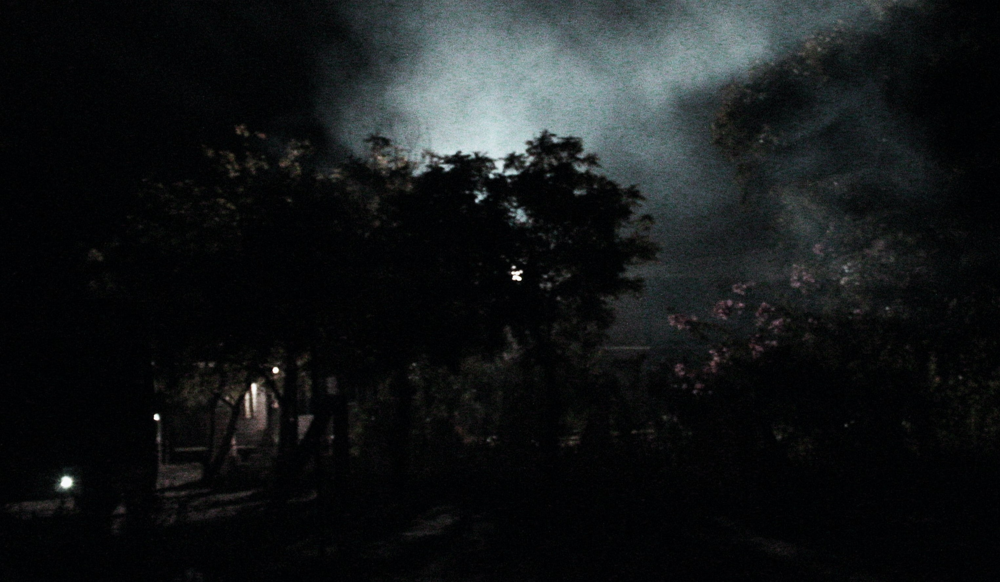

In [ ]:
# getting image
img=cv2.imread("/content/Night2.jpg")
cv2_imshow(img)

Performing Gamma Transform

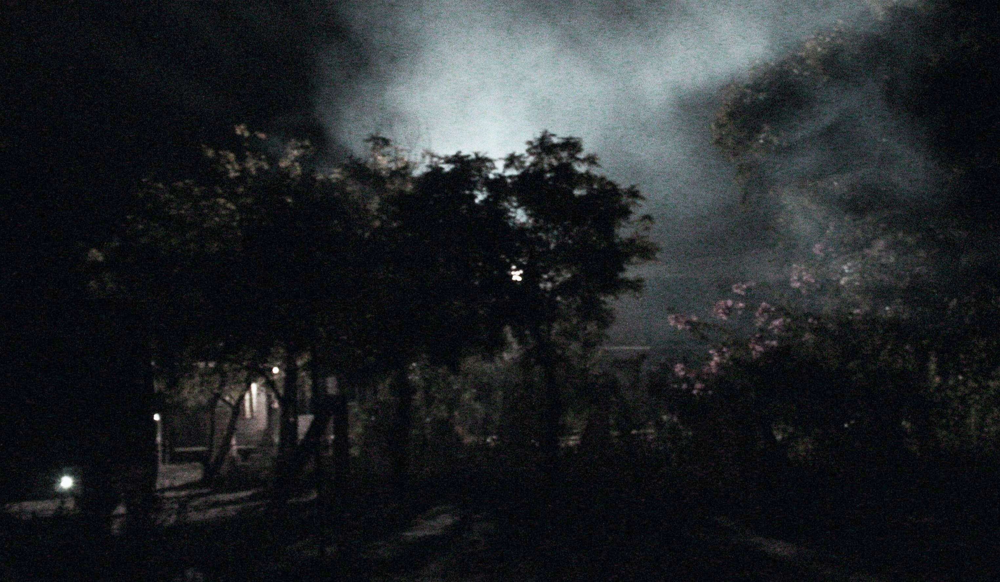

In [ ]:
img1=img/255.0
img1=img1**0.7
img1=img1*255.0
cv2_imshow(img1)

Plotting Histogram of gamma transformed image

The image is split into R, G, and B and histogram is plotted for all.

In [ ]:
# spliiting the image into the 3 color channels
(B, G, R) = cv2.split(img1)
B=np.uint8(B)
G=np.uint8(G)
R=np.uint8(R)

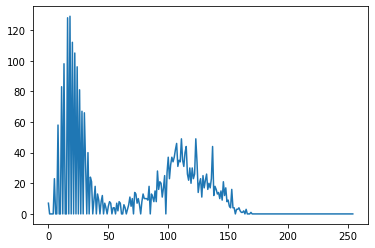

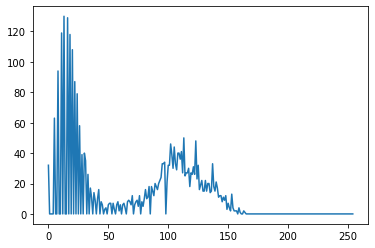

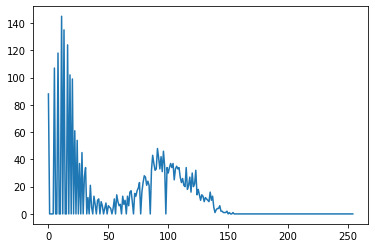

In [ ]:

# Histogram plot of R, G, and B components of image
histogram=cv2.calcHist(B,[0],None, [255], [0, 255])
plt.plot(histogram)
plt.show()

histogram=cv2.calcHist(G,[0],None, [255], [0, 255])
plt.plot(histogram)
plt.show()

histogram=cv2.calcHist(R,[0],None, [255], [0, 255])
plt.plot(histogram)
plt.show()

Histogram plotting were referred from OpenCV

https://docs.opencv.org/3.4/d4/d1b/tutorial_histogram_equalization.html

Getting Reference image

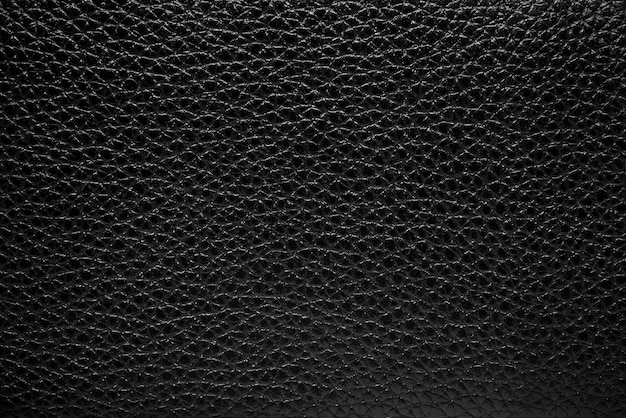

(418, 626)

In [ ]:
# getting image
ref=cv2.imread("/content/reference.jpg", 0)
cv2_imshow(ref)
ref.shape

Plotting Histogram of reference image

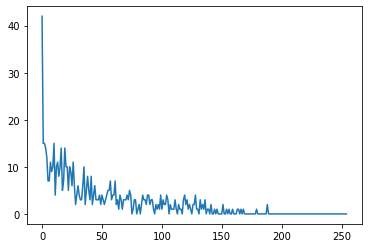

In [ ]:
# Histogram plot of R, G, and B components of image
histogram=cv2.calcHist(ref,[0],None, [255], [0, 255])
plt.plot(histogram)

Histogram matching R, G, and B  components

In [ ]:
# matching reference and Blue component
matB = match_histograms(B, ref)


# matching reference and Green component
matG = match_histograms(G, ref)


# matching reference and Red component
matR = match_histograms(R, ref)


Histogram matching was referred from: https://scikit-image.org/docs/stable/auto_examples/color_exposure/plot_histogram_matching.html

Merging R, G, and B components




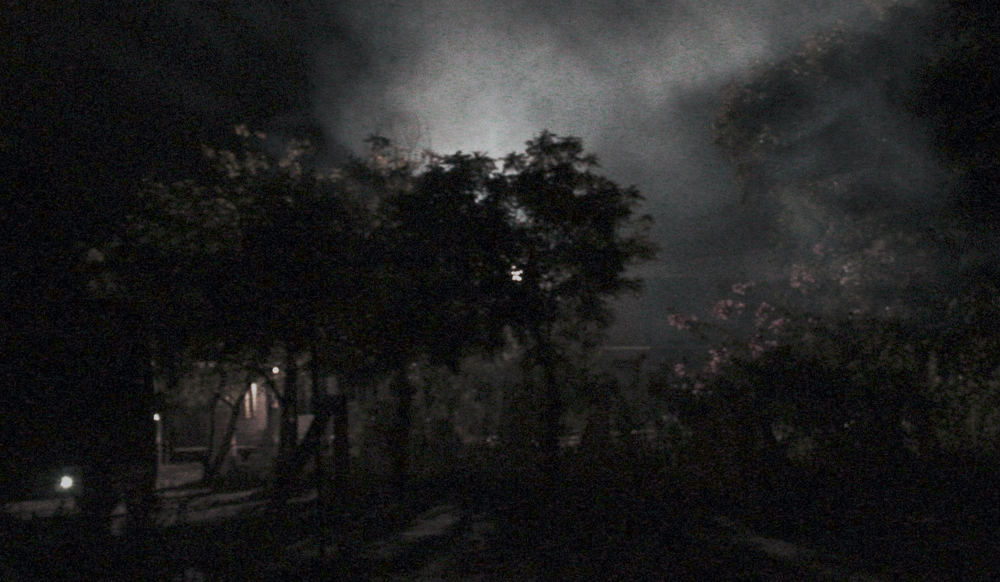

In [ ]:
merged = cv2.merge([matB, matG, matR])
cv2_imshow(merged)

Denoising

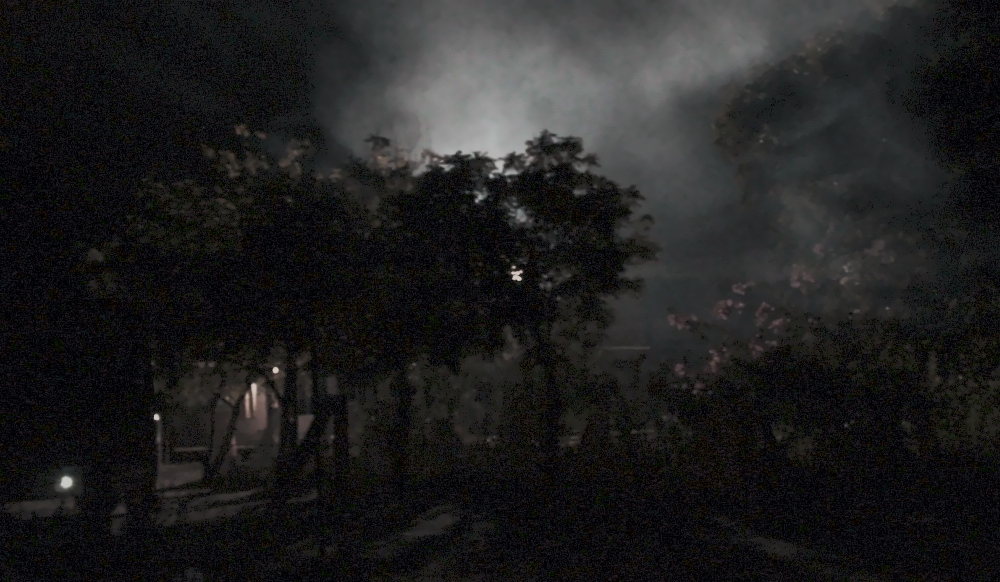

In [ ]:
# denoising a colored image
merged=np.uint8(merged)
denoised = cv2.fastNlMeansDenoisingColored(merged,None,7,7,9,22) 

cv2_imshow(denoised)

# Question 2

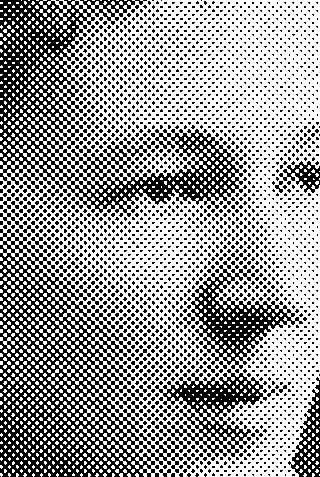

In [ ]:
# read the neswpaper image in grayscale
img = cv2.imread("/content/newspaper-dots.jpg", 0) 
cv2_imshow(img) 

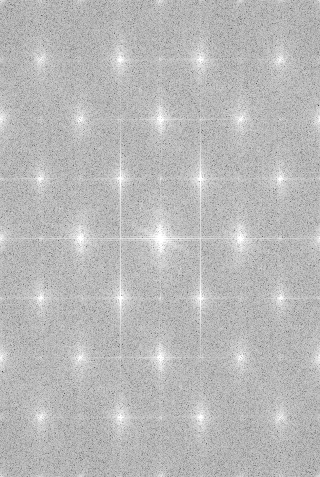

In [ ]:
f = np.fft.fft2(img)
f = np.fft.fftshift(f)
mag = 20*np.log(np.abs(f)) 
cv2_imshow(mag)

Reference for fourier transform
https://numpy.org/doc/stable/reference/routines.fft.html

Notch reject function

In [ ]:
def notch_reject(shape, r=9, x=0, y=0):
    X, Y = shape
    # Initialize filter with zeros
    noise = np.zeros((X, Y))
    for i in range(0, X):
        for j in range(0, Y):
            # Get euclidean distance from point D(u,v) to the center
            D = np.sqrt((i - X / 2 + x) ** 2 + (j - Y / 2 + y) ** 2)
            D1 = np.sqrt((i - X / 2 - x) ** 2 + (j - Y / 2 - y) ** 2)
            if D <= r or D1 <= r:
                noise[i, j] = 0.0
            else:
                noise[i, j] = 1.0
    return noise

In [ ]:
f1 = np.fft.fft2(img)
f1_shift = np.fft.fftshift(f1)
magnitude_spectrum = 20*np.log(np.abs(f1_shift))

shape = img.shape

In [ ]:
# the different notch reject 
A = notch_reject(shape, 20, 0, 80)
B = notch_reject(shape, 20, 60, 40)
C = notch_reject(shape, 20, -60, 40)
D = notch_reject(shape, 20, 120, 80)
E = notch_reject(shape, 20, -120, 80)
F = notch_reject(shape, 20, 120, 0)
G = notch_reject(shape, 20, -180, 40)
H= notch_reject(shape, 20, -60, 120)
I= notch_reject(shape, 20, -180, 120)
J = notch_reject(shape, 20, 180, 40)
K = notch_reject(shape, 20, 60, 120)
L = notch_reject(shape, 20, 180, 120)


In [ ]:
# the combined notch reject filter
notch = A*B*C*D*E*F*G*H*I*J*K*L
notch = np.uint8(notch)
Notch = f1_shift * notch 
mag_3 = 20*np.log(np.abs(Notch))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log
  """


In [ ]:
notch = np.fft.ifftshift(Notch)
i_notch = np.fft.ifft2(notch) 
Final = np.abs(i_notch)

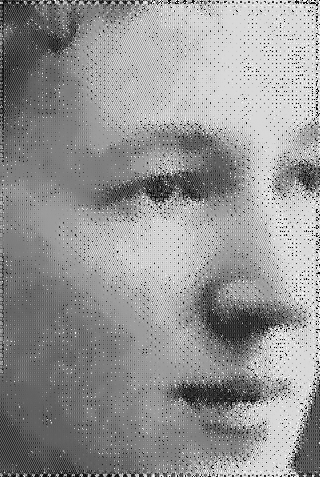

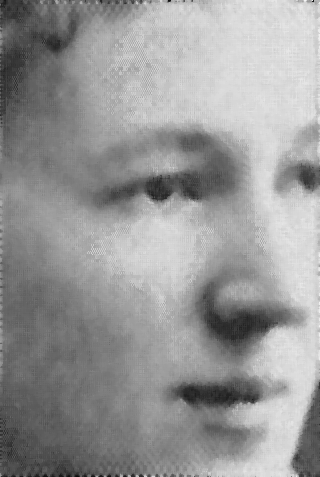

In [ ]:
Final = np.uint8(Final)
# denoise the obtained image
noiseless = cv2.fastNlMeansDenoising(Final,None,14,8,222) 
cv2_imshow(noiseless)

# median filtering
median = cv2.medianBlur(Final, 5)
cv2_imshow(median)

Using Low pass filter

# Getting image

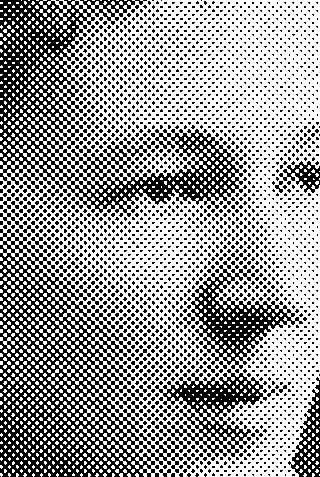

(477, 320)

In [ ]:
# read the neswpaper image in grayscale
img = cv2.imread("/content/newspaper-dots.jpg", 0) 
cv2_imshow(img)
img.shape

Using FFT

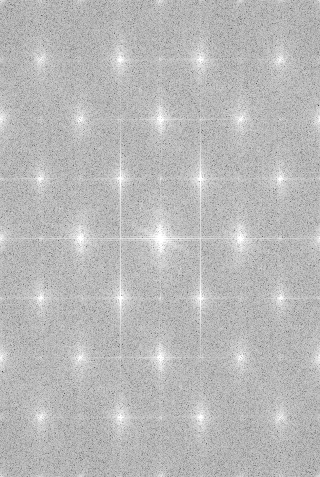

(477, 320)

In [ ]:
f = np.fft.fft2(img)
f = np.fft.fftshift(f) # for shifting lower frequencies to the centre
mag = 20*np.log(np.abs(f)) 
cv2_imshow(mag)
mag.shape

Using lowpass

That is cutting out only the centre bright of FFT

In [ ]:
radius = 50 
mask = np.zeros(img.shape)
mask[195:285,120:200]=1

In [ ]:
# blur the mask to reduce ringing effects
mask1 = cv2.GaussianBlur(mask, (27,27), 0)

Masking the image and cutting out only the centre high

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  


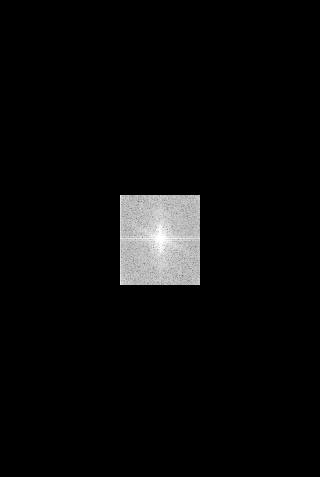

In [ ]:

F=f*mask
mag_f_masked = 20*np.log(np.abs(F))
cv2_imshow(mag_f_masked)

Taking inverse fourier transform and denoising

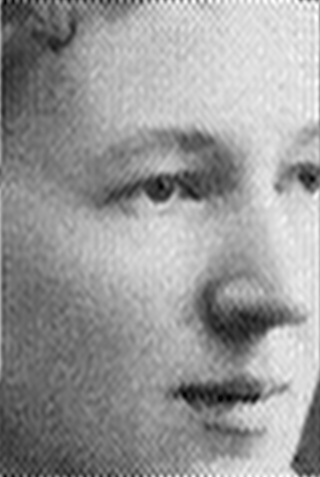

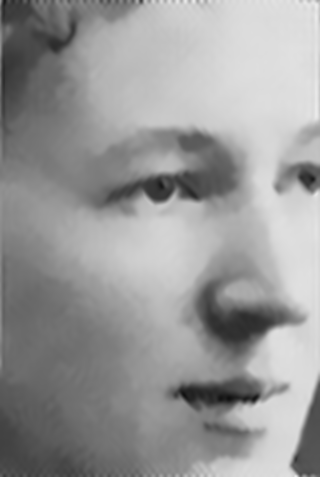

In [ ]:

shift_masked = np.fft.ifftshift(F)
i_fil = np.fft.ifft2(shift_masked, axes=(0,1))
i_fil = np.abs(i_fil).clip(0,255).astype(np.uint8)
cv2_imshow(i_fil)

# denoise the obtained image
noiseless = cv2.fastNlMeansDenoising(i_fil,None,15,9,25) 
cv2_imshow(noiseless)

# Question 5

In [ ]:
#importing required libraries
import matplotlib.pyplot as plt
import numpy as np
import cv2 as cv2
from google.colab.patches import cv2_imshow
from skimage.exposure import match_histograms

Getting the images from a file the drive ans storing then into an array

In [ ]:
from os import listdir
from os.path import isfile, join
mypath='/content/drive/MyDrive/ML'
onlyfiles = [ f for f in listdir(mypath) if isfile(join(mypath,f)) ]
images = np.empty(len(onlyfiles), dtype=object)
for n in range(0, len(onlyfiles)):
  images[n] = cv2.imread( join(mypath,onlyfiles[n]), 0 )

We are using the first 16 images in images array as our training test and the last 5 as our validation set

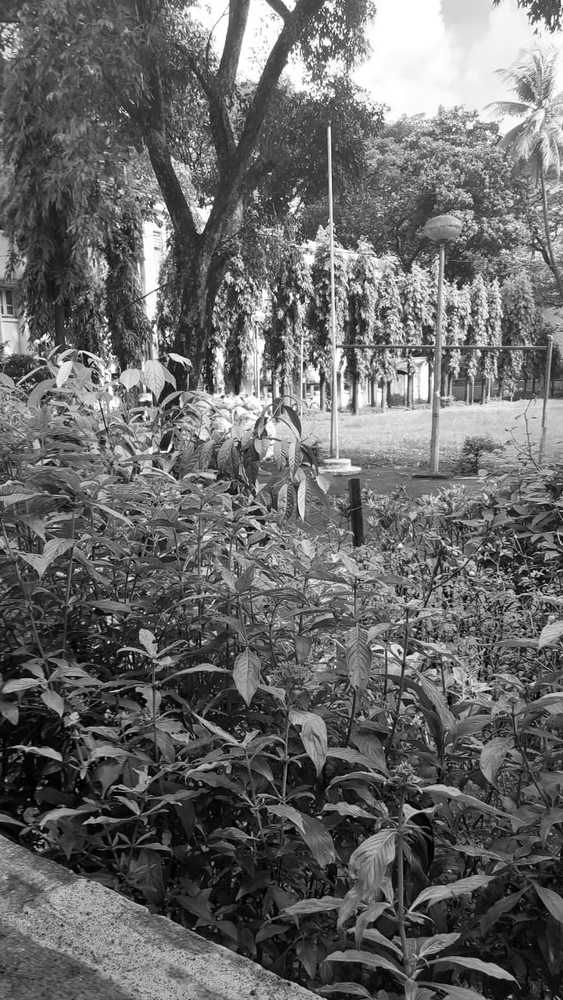

In [ ]:
# Printing a image
cv2_imshow(images[8])

degrading the images


Using Gaussian blur, Mean blur, Motion blur
And Salt and pepper noise, Gaussian noise, and Poisson noise

In [ ]:
import random as r
kerlis=[5,7,9,11,1,3]
from os import listdir
from os.path import isfile, join
import numpy
import cv2
deg=numpy.empty(21,dtype=object)
mypath='/content/drive/MyDrive/ML'
onlyfiles = [ f for f in listdir(mypath) if isfile(join(mypath,f)) ]
images = numpy.empty(len(onlyfiles), dtype=object)
for n in range(0, len(onlyfiles)):
  images[n] = cv2.imread( join(mypath,onlyfiles[n]), 0)
#blurring random images with mean blur
for i in [1,5,10,11,20,14,17]:
  ker=r.choice(kerlis)
  deg[i]=cv2.blur(images[i],(ker,ker))
#blurring random images with gaussian blur
for i in [2,6,12,13,19,18,4]:
  ker=r.choice(kerlis)
  deg[i]=cv2.GaussianBlur(images[i],(ker,ker),0)
mblis=[15,21,25,31,35]
#blurring random images with motion blur
for i in [3,7,8,9,15,16,0]:
  mbker=r.choice(mblis)
  psf6=np.zeros((mbker,mbker))
  kernel_motion_blur=cv2.ellipse(psf6,(mbker//2,mbker//2),(mbker//2,3),r.choice(list(range(360))),0,360,-1)
  kernel_motion_blur=kernel_motion_blur/np.sum(kernel_motion_blur)
  deg[i] = cv2.filter2D(images[i], -1, kernel_motion_blur)

Function for generating noise

In [ ]:
import numpy as np
import os
import cv2
def noisy(noise_typ,image):
   if noise_typ == "gauss":
      row,col= image.shape
      mean = 0
      var = 0.1
      sigma = var**0.5
      gauss = np.random.normal(mean,sigma,(row,col))
      gauss = gauss.reshape(row,col)
      noisy = image + gauss
      return noisy
   elif noise_typ == "sp":
      row,col = image.shape
      s_vs_p = 0.4
      amount = 0.006
      out = np.copy(image)
      # Salt mode
      num_salt = np.ceil(amount * image.size * s_vs_p)
      coords = [np.random.randint(0, i - 1, int(num_salt))
              for i in image.shape]
      out[coords] = 1

      # Pepper mode
      num_pepper = np.ceil(amount* image.size * (1. - s_vs_p))
      coords = [np.random.randint(0, i - 1, int(num_pepper))
              for i in image.shape]
      out[coords] = 0
      return out
   elif noise_typ == "poisson":
      vals = len(np.unique(image))
      vals = 2 ** np.ceil(np.log2(vals))
      noisy = np.random.poisson(image * vals) / float(vals)
      return noisy

Adding noise to each image

each image is given one of the three noise

And the images are given random gamma transform and change in pixel values

In [ ]:
for i in range(7):
  deg[i*3]=noisy("gauss",deg[i*3])
  deg[i*3+1]=noisy("sp",deg[i*3+1])
  deg[i*3+2]=noisy("poisson",deg[i*3+2])
for i in range(200):
  n=r.choice(list(range(21)))
  deg[n]=deg[n][:,:]+r.choice([-2,-1,0,1,2])
for i in range(200):
  n=r.choice(list(range(21)))
  deg[n]=deg[n]/255.0
  deg[n]=deg[n]**r.choice([0.9,1,1.1])
  deg[n]=deg[n]*255

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in power
  # This is added back by InteractiveShellApp.init_path()


In [ ]:
# cv2_imshow(deg[15])

First tried to shuffle the degraded image array and latter decided not to.

In [ ]:
#np.random.shuffle(deg)

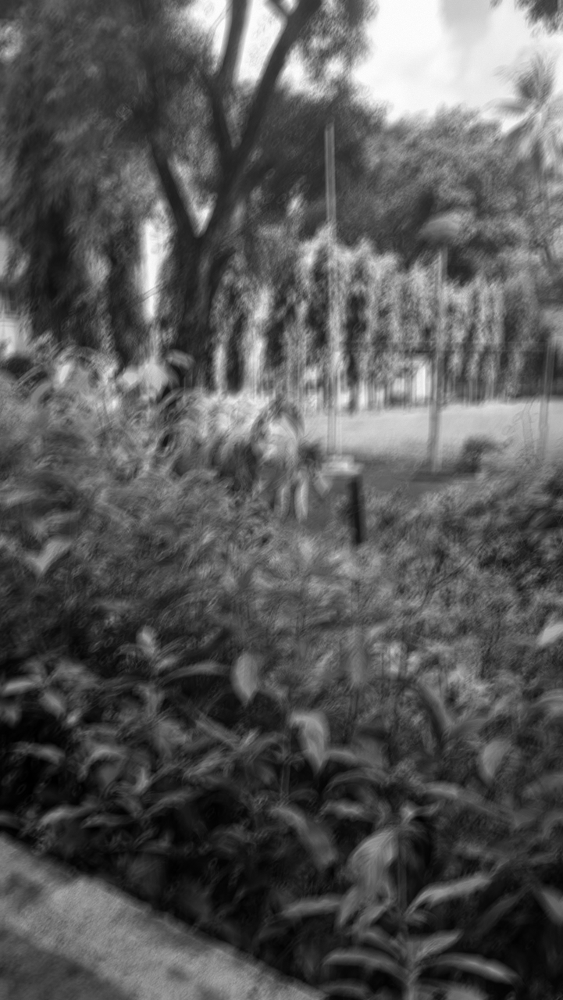

In [ ]:
#random image of deg array
cv2_imshow(deg[8])

Getting training data


I am using 16 images and each contributing 400 patches

window size =5x5

In [ ]:
W=5//2
X_train=np.empty((5*5))
for i in range(16) :
  y, x=deg[i].shape
  r=x//21
  c=y//21
  for j in range(0, 20):
    for k in range(0, 20):
      centrex=r*(k+1);
      centrey=c*(j+1);
      new=np.array(deg[i][centrey-W:centrey+W+1,centrex-W:centrex+W+1]).flatten()
      X_train=np.append(X_train,new, axis=0)
      
      

X_train=X_train[25:]
X_train=X_train.reshape((6400,25))

In [ ]:
print(X_train)
X_train.shape


[[194.28234338 193.73320156 193.66091648 ... 193.65452615 193.74944482
  193.55939536]
 [195.75981913 195.77282932 195.57453076 ... 195.83871273 195.76386468
  194.98122562]
 [197.01746996 196.77280002 196.972884   ... 197.1109274  197.405293
  197.04429172]
 ...
 [ 29.06551071  26.47835271  26.1263935  ...  71.87069767  69.99763797
   65.76215158]
 [101.6954926   98.49201543  97.47408747 ... 103.27681233 100.05237395
   98.11836354]
 [109.93517545 112.42340431 112.33879775 ... 107.87958934 111.32081506
  110.55174545]]


(6400, 25)

In [ ]:

X_train[np.isnan(X_train)]=0
m=np.sum(np.isnan(X_train))
X_train

array([[194.28234338, 193.73320156, 193.66091648, ..., 193.65452615,
        193.74944482, 193.55939536],
       [195.75981913, 195.77282932, 195.57453076, ..., 195.83871273,
        195.76386468, 194.98122562],
       [197.01746996, 196.77280002, 196.972884  , ..., 197.1109274 ,
        197.405293  , 197.04429172],
       ...,
       [ 29.06551071,  26.47835271,  26.1263935 , ...,  71.87069767,
         69.99763797,  65.76215158],
       [101.6954926 ,  98.49201543,  97.47408747, ..., 103.27681233,
        100.05237395,  98.11836354],
       [109.93517545, 112.42340431, 112.33879775, ..., 107.87958934,
        111.32081506, 110.55174545]])

The above block gives Nx(W*W)

N=6400, W=5

In [ ]:
Y_train=np.array([0])
for i in range(16):
  y, x=images[i].shape
  r=x//21
  c=y//21
  for j in range(0, 20):
    for k in range(0, 20):
      centrex=r*(k+1);
      centrey=c*(j+1);
      Y_train=np.append(Y_train,np.array(images[i][centrey][centrex]))
      

Y_train=Y_train[1:]
Y_train.shape

(6400,)

Nx1 array 

N=6400

In [ ]:
Y_train

array([200, 202, 203, ...,   8,  60,  79])

Getting testing data


I am using 5 images and each contributing 400 patches

window size =5x5

In [ ]:
W=5//2
X_test=np.empty((5*5))
for i in range(16, 21) :
  y, x=deg[i].shape
  r=x//21
  c=y//21
  for j in range(0, 20):
    for k in range(0, 20):
      centrex=r*(k+1);
      centrey=c*(j+1);
      new=np.array(deg[i][centrey-W:centrey+W+1,centrex-W:centrex+W+1]).flatten()
      X_test=np.append(X_test,new, axis=0)
      
      

X_test=X_test[25:]
X_test=X_test.reshape((2000,25))

Setting all NaN values generated during blurring to 0

In [ ]:
X_test[np.isnan(X_test)]=0
n=np.sum(np.isnan(X_test))
X_test

array([[205.09446724, 205.09446724, 205.09446724, ..., 205.87333705,
        205.87333705, 205.87333705],
       [205.09446724, 205.09446724, 205.09446724, ..., 205.09446724,
        205.09446724, 205.09446724],
       [203.53316828, 203.53316828, 203.53316828, ..., 203.53316828,
        203.53316828, 203.53316828],
       ...,
       [205.80176943, 203.40895236, 195.52375132, ..., 148.63494364,
        128.41700641, 109.50729747],
       [137.02565496, 137.8928923 , 139.50252299, ..., 185.10158912,
        186.7927394 , 188.44275205],
       [208.79441108, 209.15349679, 208.65685782, ..., 208.8982445 ,
        208.95435874, 209.96858549]])

The above block gives Mx(W*W)

M=2000, W=5

In [ ]:
Y_test=np.array([0])
for i in range(16, 21):
  y, x=images[i].shape
  r=x//21
  c=y//21
  for j in range(0, 20):
    for k in range(0, 20):
      centrex=r*(k+1);
      centrey=c*(j+1);
      Y_test=np.append(Y_test,np.array(images[i][centrey][centrex]))
      

Y_test=Y_test[1:]
Y_test


array([193, 191, 190, ..., 167, 134, 176])

The above code gives Mx1

M=2000

Machine Learing Model(Suppot Vector Regressor)

In [ ]:

from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import MinMaxScaler

Did not use min max scalar because i thought scaling back the predicted output would be difficult for this

Instead divided each value by 255

In [ ]:
# scalar = MinMaxScaler()
# model1=scalar.fit(XY_train)
# xy_train=model1.transform(XY_train)
# scaler = MinMaxScaler()
# model2=scalar.fit(XY_test)
# xy_test=model2.transform(XY_test)

In [ ]:
x_train=X_train/255.0
x_test=X_test/255.0
y_train=Y_train/255.0
y_test=Y_test/255.0

SVR model

In [ ]:
regressor = SVR(kernel='rbf', C=0.1, epsilon=0.01, gamma=1)
regressor.fit(x_train,y_train)
y_pred = regressor.predict(x_test)
mean_squared_error(y_test, y_pred)

0.015729116623398254

The mean square error comes out to be 0.01536 for this set of parameters

In [ ]:
#Predicted values
y_pred

array([0.79358824, 0.79074828, 0.78630066, ..., 0.73536223, 0.66660773,
       0.79816535])

In [ ]:
#max value in pred array
np.max(y_pred)

0.9930220446513978

Getting Image to test

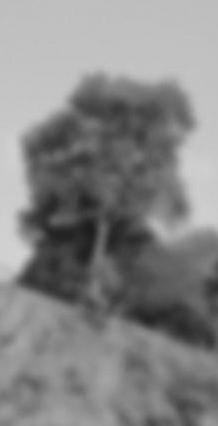

In [ ]:
num=cv2.imread('/content/Badimage.jpeg', 0)
cv2_imshow(num)

Shape of image after adding padding

In [ ]:
x, y=num.shape
pad=np.zeros((x+4,y+4))
pad[2:x+2,2:y+2]=num
pad.shape

(430, 222)

Generating X test for predicting

In [ ]:
W=5//2
Xtest=np.empty((5*5))
y, x=pad.shape


for j in range(2, y-2):
  for k in range(2, x-2):
      Xtest=np.append(Xtest,np.array(pad[j-W:j+W+1,k-W:k+W+1]).flatten())
      
      

Xtest=Xtest[25:]
Xtest=Xtest.reshape((x-4)*(y-4),25)
Xtest

array([[  0.,   0.,   0., ..., 190., 190., 190.],
       [  0.,   0.,   0., ..., 190., 190., 190.],
       [  0.,   0.,   0., ..., 190., 190., 190.],
       ...,
       [148., 147., 147., ...,   0.,   0.,   0.],
       [147., 147., 143., ...,   0.,   0.,   0.],
       [147., 143., 143., ...,   0.,   0.,   0.]])

In [ ]:
x,y=Xtest.shape
Xtest.shape

(92868, 25)

Predicting after scaling

In [ ]:
xtest=Xtest/255.0
y_pred = regressor.predict(xtest)

Limiting the predicted values in 0 to 1 range

In [ ]:
max=np.max(y_pred)
min=np.min(y_pred)
y_pred=(y_pred-min)/(max-min)

In [ ]:
np.max(y_pred)

1.0

In [ ]:
#predicted array
y_pred

array([0.6454603 , 0.69556569, 0.77421463, ..., 0.5674165 , 0.59920623,
       0.54977545])

In [ ]:
#Reshaping it back to original image shape
Final=y_pred.reshape(426,218)

In [ ]:
#Scaling back to 0 to 255 range
Final=Final*255

In [ ]:
# final image array
Final

array([[164.59237578, 177.36925065, 197.424731  , ..., 197.27313449,
        181.2420677 , 161.81017047],
       [178.03401822, 187.15613634, 216.1732195 , ..., 215.61500385,
        180.48914324, 165.32238879],
       [189.49923036, 209.92128273, 230.17782227, ..., 229.07637215,
        202.04823599, 177.08944755],
       ...,
       [151.33142143, 161.42385857, 155.26937585, ..., 177.01082795,
        187.33222773, 155.32928715],
       [144.69535298, 159.89892219, 166.03388038, ..., 195.18098733,
        172.54419505, 153.19696985],
       [118.05669041, 135.8079072 , 125.9562073 , ..., 144.69120777,
        152.79758901, 140.19274008]])

Comparing original and predicted image

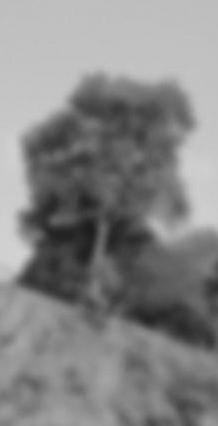

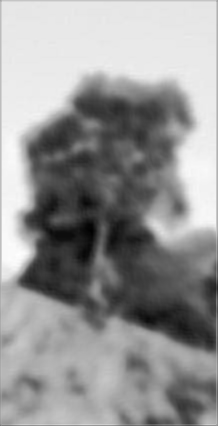

In [ ]:
cv2_imshow(num)
cv2_imshow(Final)

I obtained best image for 5x5 kernal

# Question 3

First I am trying out on the gray scale version and moving on to color image if this works like i intend it to.

In [ ]:
# importing required libraries

import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow


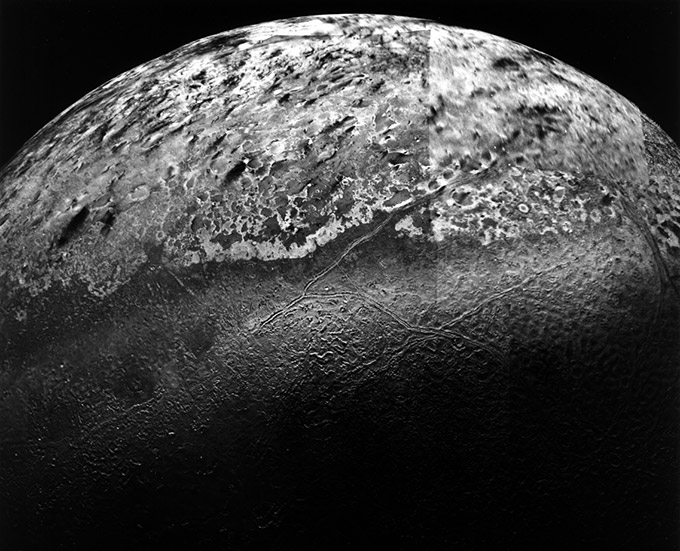

In [ ]:
#getting the image in gray sclae
tri=cv2.imread('/content/triton.jpg', 0)
cv2_imshow(tri)
gray=np.float32(tri)

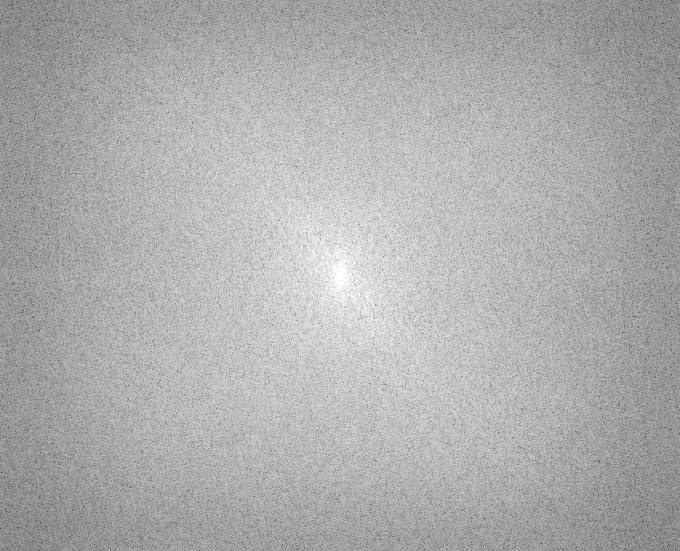

In [ ]:
# Taking Dft and centralising
dftgray = cv2.dft(gray, flags = cv2.DFT_COMPLEX_OUTPUT)
dft_shiftgray = np.fft.fftshift(dftgray)
maggray = 20*np.log(cv2.magnitude(dft_shiftgray[:,:,0],dft_shiftgray[:,:,1]))
cv2_imshow(maggray)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log
  # This is added back by InteractiveShellApp.init_path()


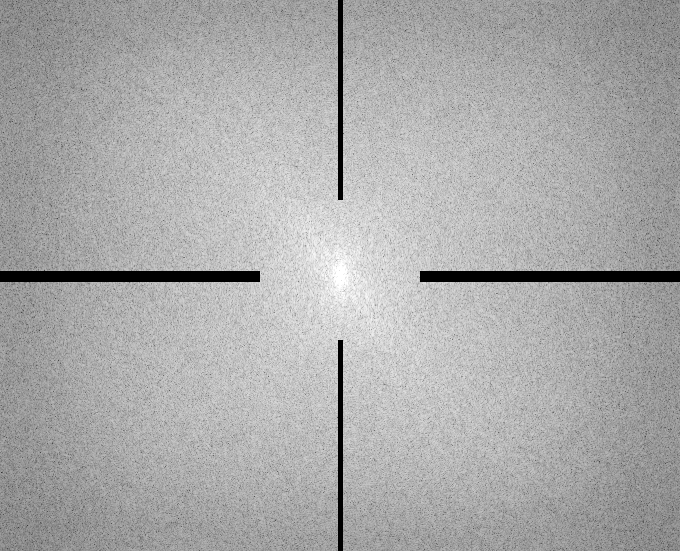

In [ ]:
#masking vertical scan lines
mask1 = np.ones((551,680,2),np.uint8)
mask2 = np.ones((551,680,2),np.uint8)
mask3 = np.ones((551,680,2),np.uint8)
mask4 = np.ones((551,680,2),np.uint8)
mask1[271:282,:260]=[0,0]
mask2[271:282,420:]=[0,0]
mask3[:200,338:343]=[0,0]
mask4[340:,338:343]=[0,0]
dft_shiftgray=dft_shiftgray*mask1*mask2*mask3*mask4
maggray = 20*np.log(cv2.magnitude(dft_shiftgray[:,:,0],dft_shiftgray[:,:,1]))
cv2_imshow(maggray)

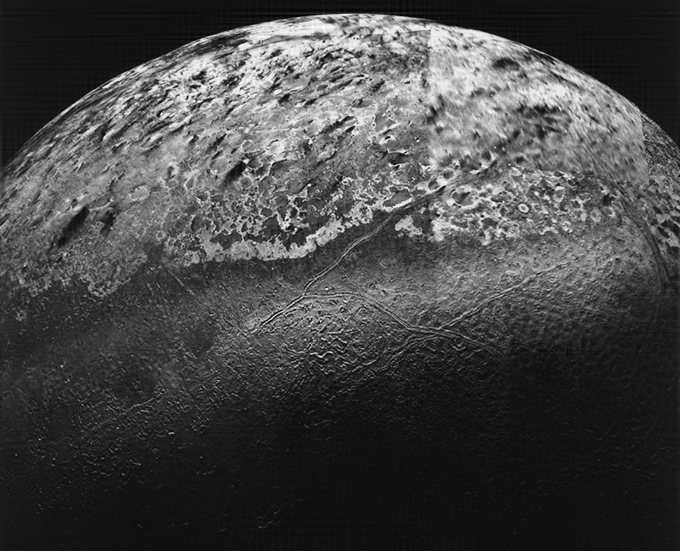

In [ ]:
f_ishiftgray = np.fft.ifftshift(dft_shiftgray)
trifilgray = cv2.idft(f_ishiftgray)
trifilgray= trifilgray[:,:,0]
trifilgray = cv2.normalize(trifilgray, None, alpha=0, beta=1.0, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
trifilgray=trifilgray*255
cv2_imshow(trifilgray)

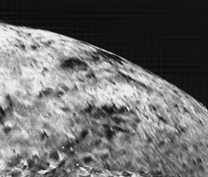

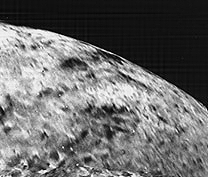

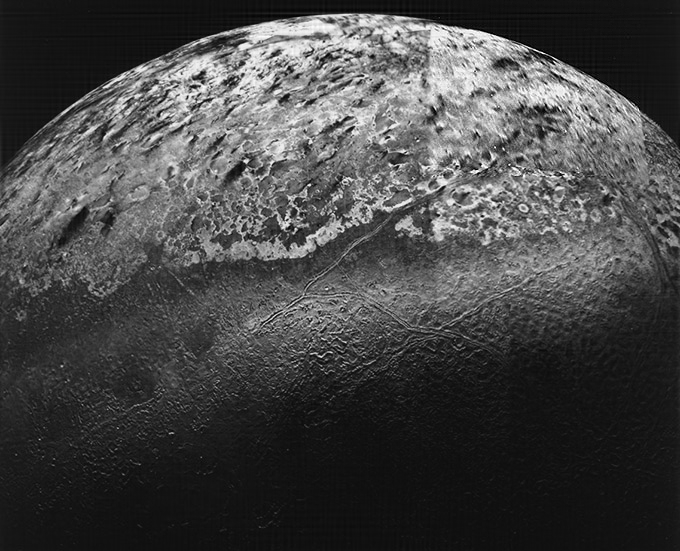

In [ ]:
img=trifilgray[:177,432:640]
cv2_imshow(img)
img=np.uint8(img)
kernel = np.array([[0,-0.25,0], [-0.25,1,-0.25], [0,-0.25,0]])
img =img + cv2.filter2D(src=img, ddepth=cv2.CV_16S, kernel=kernel)
cv2_imshow(img)
trifilgray[:177,432:640]=img
cv2_imshow(trifilgray)

2D filter referece
https://www.geeksforgeeks.org/python-opencv-filter2d-function/

Since the output seems satisfactory

I am moving on to color image

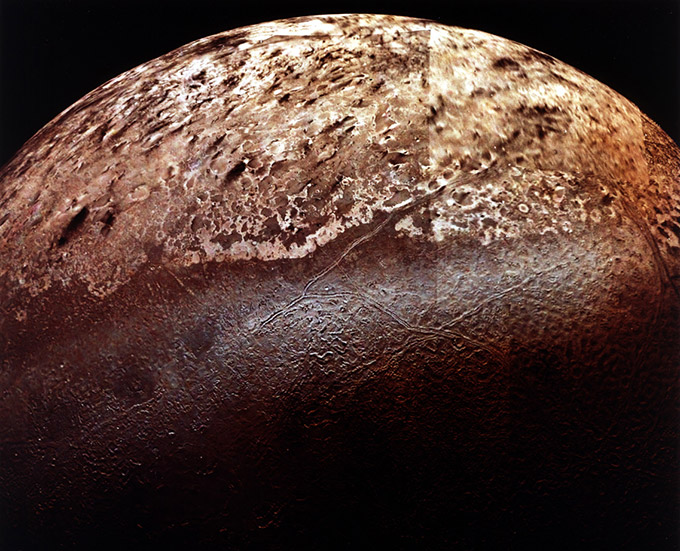

In [ ]:
#importing required libraries
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow

#getting image
tri=cv2.imread('/content/triton.jpg')
cv2_imshow(tri)

Splitting image into R, G, B components

In [ ]:
(B, G, R) = cv2.split(tri)
bf = np.float32(B)
gf = np.float32(G)
rf = np.float32(R)

Taking DFT for R, G and B

In [ ]:
dftb = cv2.dft(bf, flags = cv2.DFT_COMPLEX_OUTPUT)
dftg = cv2.dft(gf, flags = cv2.DFT_COMPLEX_OUTPUT)
dftr = cv2.dft(rf, flags = cv2.DFT_COMPLEX_OUTPUT)
dft_shiftb = np.fft.fftshift(dftb)
dft_shiftg = np.fft.fftshift(dftg)
dft_shiftr = np.fft.fftshift(dftr)

In [ ]:
mask1 = np.ones((551,680,2),np.uint8)
mask2 = np.ones((551,680,2),np.uint8)
mask3 = np.ones((551,680,2),np.uint8)
mask4 = np.ones((551,680,2),np.uint8)
mask1[271:282,:280]=[0,0]
mask2[271:282,400:]=[0,0]
mask3[:200,338:343]=[0,0]
mask4[340:,338:343]=[0,0]
dft_shiftb=dft_shiftb*mask1*mask2*mask3*mask4
dft_shiftg=dft_shiftg*mask1*mask2*mask3*mask4
dft_shiftr=dft_shiftr*mask1*mask2*mask3*mask4

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


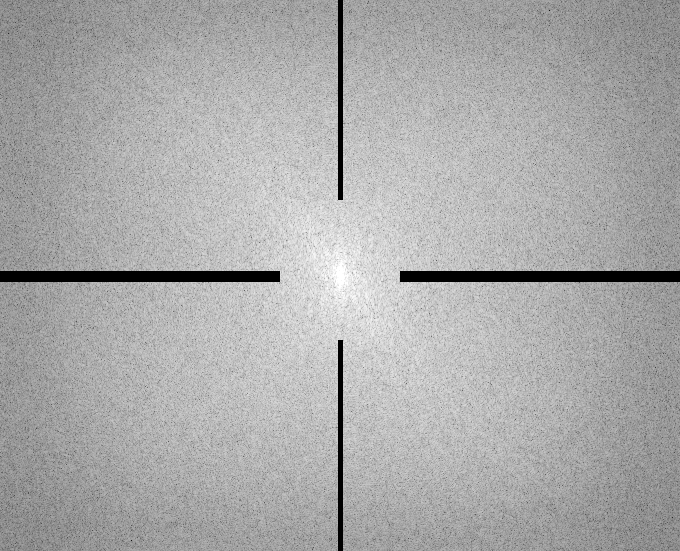

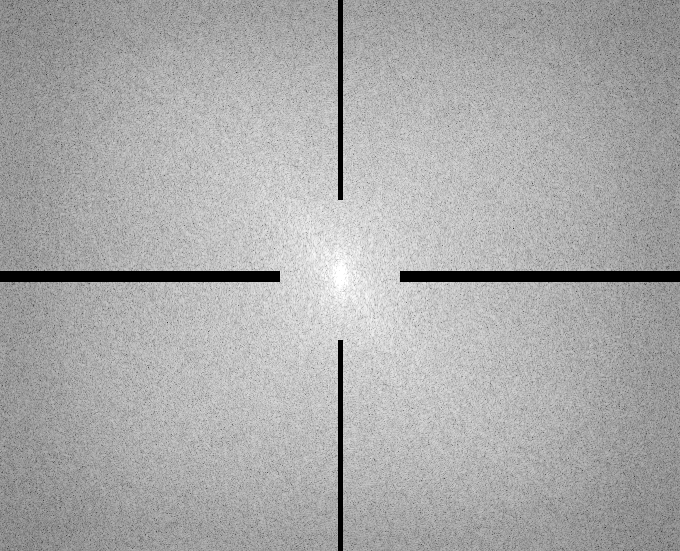

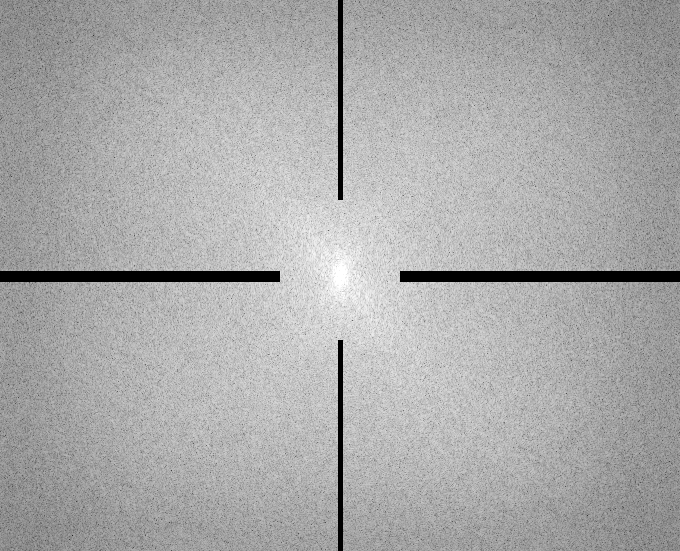

In [ ]:
magb = 20*np.log(cv2.magnitude(dft_shiftb[:,:,0],dft_shiftb[:,:,1]))
magg = 20*np.log(cv2.magnitude(dft_shiftg[:,:,0],dft_shiftg[:,:,1]))
magr = 20*np.log(cv2.magnitude(dft_shiftr[:,:,0],dft_shiftr[:,:,1]))

cv2_imshow(magb)
cv2_imshow(magg)
cv2_imshow(magr)

In [ ]:
f_ishiftb = np.fft.ifftshift(dft_shiftb)
f_ishiftg = np.fft.ifftshift(dft_shiftg)
f_ishiftr = np.fft.ifftshift(dft_shiftr)

Inverse fourier transfer and merging the RGB components

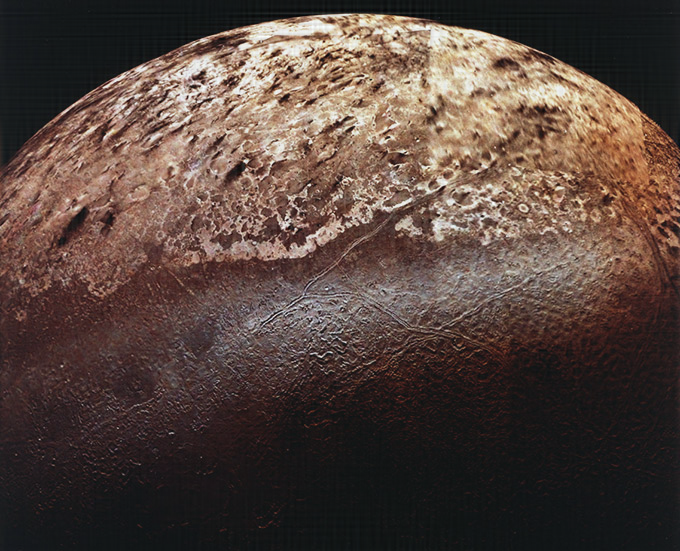

In [ ]:
trifilr = cv2.idft(f_ishiftr)
trifilr= trifilr[:,:,0]
trifilr = cv2.normalize(trifilr, None, alpha=0, beta=1.0, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
trifilr=trifilr*255

trifilb = cv2.idft(f_ishiftb)
trifilb= trifilb[:,:,0]
trifilb = cv2.normalize(trifilb ,None, alpha=0, beta=1.0, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
trifilb=trifilb*255

trifilg = cv2.idft(f_ishiftg)
trifilg= trifilg[:,:,0]
trifilg = cv2.normalize(trifilg, None, alpha=0, beta=1.0, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
trifilg=trifilg*255

trirgb=cv2.merge([trifilb,trifilg,trifilr])
cv2_imshow(trirgb)

Since the patch near the top right corner is somewhat blurred compared to the rest of the image 


So I am sharpening only that part

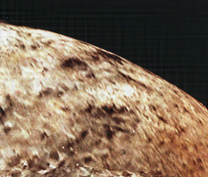

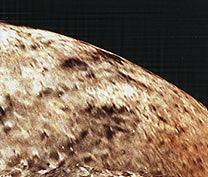

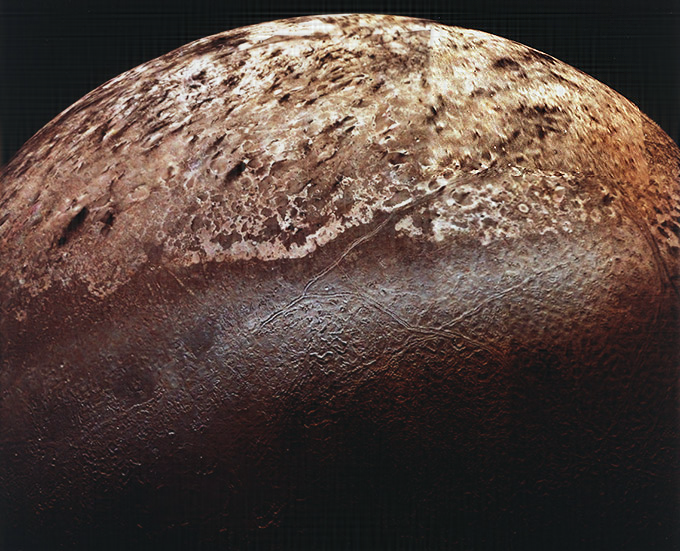

In [ ]:
img=trirgb[:177,432:640]
cv2_imshow(img)
img=np.uint8(img)
kernel = np.array([[0,-0.25,0], [-0.25,1,-0.25], [0,-0.25,0]])# kernal for sharpening
img =img + cv2.filter2D(src=img, ddepth=cv2.CV_16S, kernel=kernel)# sharpening filter
#img=img/1.1
# img=img/255.0
# img=img**1.2
# img=img*255.0
cv2_imshow(img)
trirgb[:177,432:640]=img
cv2_imshow(trirgb)

decided not to apply gamma function or brightness reduction to darken the image and go with the above one

Printing original image and processed image for comparison

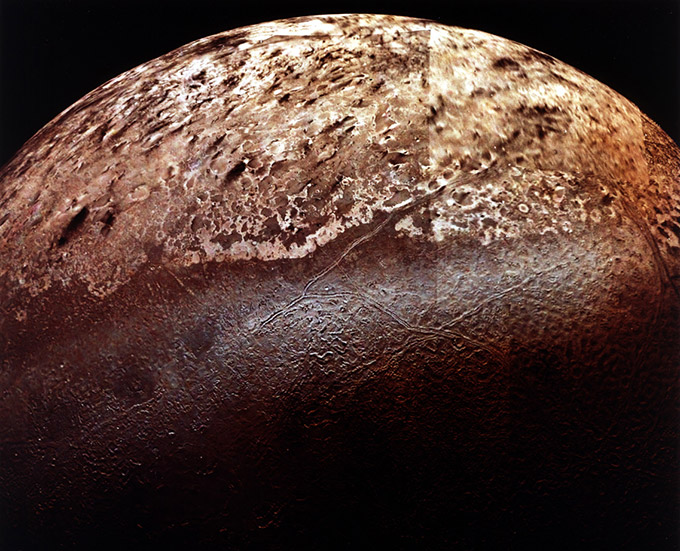

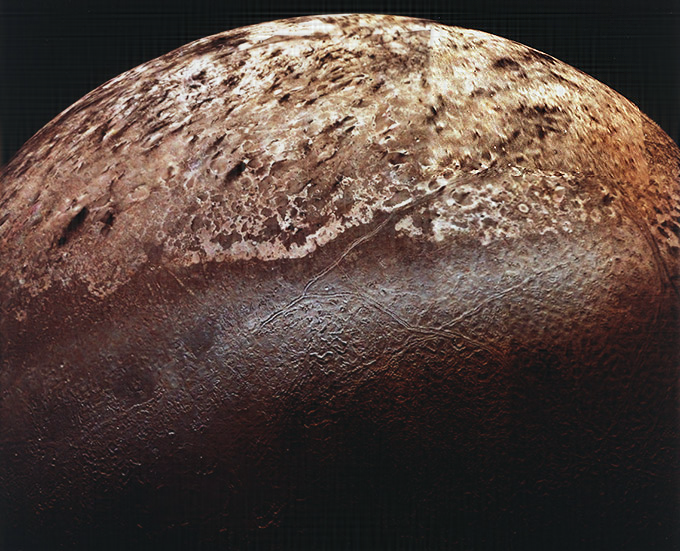

In [ ]:
cv2_imshow(tri)
# trirgbf=trirgb/255.0

# trirgbf=trirgbf**1.2

# trirgbf=trirgbf*255
cv2_imshow(trirgb)

We can see that the horizontal line in the original image has dimmed after processing


# Question 4

In [ ]:
#importing required libraries
import numpy as np
import matplotlib.pyplot as plt
import cv2
import math
from google.colab.patches import cv2_imshow

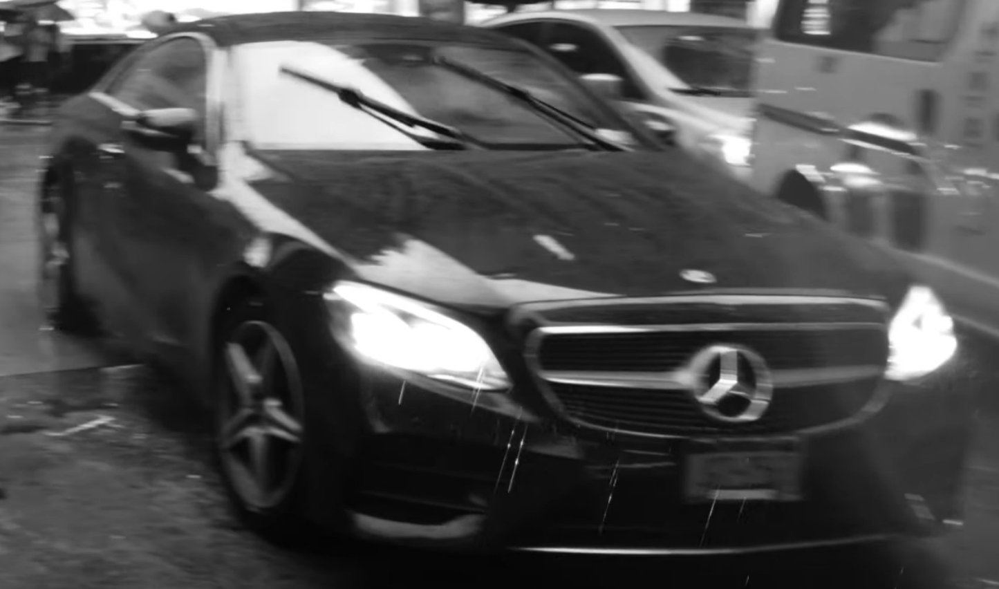

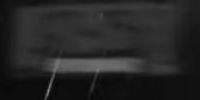

In [ ]:
#Getting car image
car=cv2.imread('/content/car.jpg',0)
cv2_imshow(car)
# cutting out the number plate part
car=car[650:750,980:1180]
cv2_imshow(car)

DFT of number plate

In [ ]:
X,Y=car.shape
blur = np.float32(car)
dft = cv2.dft(blur, flags = cv2.DFT_COMPLEX_OUTPUT)
#centralising
dft_shift = np.fft.fftshift(dft)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in log
  del sys.path[0]


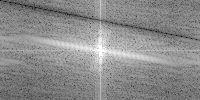

In [ ]:
H=np.zeros((X,Y))
Nk=0.001
d=0.0006
theta=15*math.pi/16#Angle of motion blur
for i in range(X):
  for j in range(Y):
    H[i,j]=math.sin(math.pi*d*(math.cos(theta)*i+math.sin(theta)*j))
carf=np.zeros((X,Y,2))
#Applying weiner filter
for i in range(X):
  for j in range(Y):
    carf[i,j]=dft_shift[i,j]*(H[i,j]/(H[i,j]**2+Nk))
mag = 20*np.log(cv2.magnitude(carf[:,:,0],carf[:,:,1]))
cv2_imshow(mag)

Taking IDFT

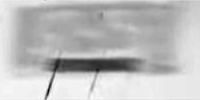

In [ ]:
f_ishift = np.fft.ifftshift(carf)
carfin = cv2.idft(f_ishift)
carfin= carfin[:,:,0]
carfin = cv2.normalize(carfin, None, alpha=0, beta=1.0, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
carfin=carfin*255
cv2_imshow(carfin)

In [ ]:
carfin.shape

(100, 200)

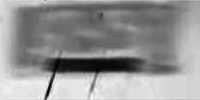

In [ ]:
# Taking gamma transform to increase contrast
number=carfin/255.0
number=number**2
number=number*255.0
cv2_imshow(number)

After taking gamma transform we can see 5-5? as the number
Last number not clearly visible

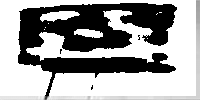

In [ ]:
#Taking threshold
for i in range(96):
  for j in range(196):
    if number[i][j]>120:
      number[i][j]=255
    else:
      number[i][j]=0
cv2_imshow(number)     

Simply inputing the number plate to the ML model we created

In [ ]:
W=5//2
Xtest=np.empty((5*5))
y, x=number.shape


for j in range(2, y-2):
  for k in range(2, x-2):
      Xtest=np.append(Xtest,np.array(pad[j-W:j+W+1,k-W:k+W+1]).flatten())
      
      

Xtest=Xtest[25:]
Xtest=Xtest.reshape((x-4)*(y-4),25)
Xtest

array([[  0.,   0.,   0., ..., 190., 190., 190.],
       [  0.,   0.,   0., ..., 190., 190., 190.],
       [  0.,   0.,   0., ..., 190., 190., 190.],
       ...,
       [185., 187., 188., ..., 184., 188., 191.],
       [187., 188., 189., ..., 188., 191., 192.],
       [188., 189., 191., ..., 191., 192., 192.]])

In [ ]:
Xtest.shape

(18816, 25)

In [ ]:
xtest=Xtest/255.0
y_pred = regressor.predict(xtest)

In [ ]:
max=np.max(y_pred)
min=np.min(y_pred)
y_pred=(y_pred-min)/(max-min)

In [ ]:
Final=y_pred.reshape(96,196)
Final=Final*255

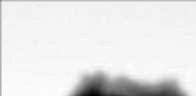

In [ ]:
cv2_imshow(Final)

The ML model is not working as expected